<a href="https://colab.research.google.com/github/jbrown544/interlingual-topic-modeling/blob/main/Interlingual_Topic_Modeling_(Part_2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Built with spaCy](https://img.shields.io/badge/built%20with-spaCy-09a3d5.svg)](https://spacy.io)

# Unsupervised Thematic Discovery in Non-English Natural Language Corpora

**Note: Use the "Open in Colab" link above to render visualizations. The "Table of contents" side panel in Google Colab is very beneficial for navigating the organization of this notebook.*

# Processing Environment

## Packages

Use pip to install the necessary packages and verify package information.

In [ ]:
# install/update dependencies

# If you observe a message such as this after running pip (bottom of output):
#
# "WARNING: The following packages were previously imported in this runtime:""
# " [ xxxx, xxxxx ]"
# "You must restart the runtime in order to use newly installed versions.""
#
# Please restart the Python runtime. Neglecting this restart may 
# result in errors during processing due to previously loaded packages.

%pip install -U google-cloud-translate \
                smart_open[gcs] \
                sklearn \
                python-Levenshtein \
                spacy \
                tomotopy \
                pyLDAvis \
                gensim                

Note: you may need to restart the kernel to use updated packages.


In [ ]:
# inspect spaCy package information

%pip show spacy

Name: spacy
Version: 3.2.0
Summary: Industrial-strength Natural Language Processing (NLP) in Python
Home-page: https://spacy.io
Author: Explosion
Author-email: contact@explosion.ai
License: MIT
Location: /opt/conda/lib/python3.9/site-packages
Requires: spacy-loggers, catalogue, cymem, tqdm, typer, thinc, spacy-legacy, srsly, jinja2, langcodes, numpy, pydantic, setuptools, packaging, blis, pathy, requests, wasabi, murmurhash, preshed
Required-by: pl-core-news-sm, pl-core-news-lg, lt-core-news-sm, lt-core-news-lg, it-core-news-sm, it-core-news-lg, fr-core-news-sm, fr-core-news-lg, en-core-web-sm, en-core-web-lg, el-core-news-sm, el-core-news-lg, da-core-news-sm, da-core-news-lg
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# inspect tomotopy package information

%pip show tomotopy

Name: tomotopy
Version: 0.12.2
Summary: Tomoto, Topic Modeling Tool for Python
Home-page: https://github.com/bab2min/tomotopy
Author: bab2min
Author-email: bab2min@gmail.com
License: MIT License
Location: /opt/conda/lib/python3.9/site-packages
Requires: numpy
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# inspect pyLDAvis package information

%pip show pyLDAvis

Name: pyLDAvis
Version: 3.3.1
Summary: Interactive topic model visualization. Port of the R package.
Home-page: https://github.com/bmabey/pyLDAvis
Author: Ben Mabey
Author-email: ben@benmabey.com
License: MIT
Location: /opt/conda/lib/python3.9/site-packages
Requires: future, scipy, funcy, numexpr, sklearn, jinja2, gensim, pandas, scikit-learn, numpy, joblib, setuptools
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# inspect Gensim package information

%pip show gensim

Name: gensim
Version: 4.1.2
Summary: Python framework for fast Vector Space Modelling
Home-page: http://radimrehurek.com/gensim
Author: Radim Rehurek
Author-email: me@radimrehurek.com
License: LGPL-2.1-only
Location: /opt/conda/lib/python3.9/site-packages
Requires: smart-open, scipy, numpy
Required-by: pyLDAvis
Note: you may need to restart the kernel to use updated packages.


## Dependencies

Import various useful tools.

In [ ]:
# supress certain warnings
import warnings

warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

In [ ]:
import json
import multiprocessing

from collections import Counter
from urllib.parse import urljoin

import numpy as np
import matplotlib.pyplot as plt

import spacy
import pyLDAvis
import tomotopy as tp
from smart_open import open
from gensim.models.phrases import Phrases

from google.cloud import translate_v2 as translate

/opt/conda/lib/python3.9/site-packages/scipy/sparse/sparsetools.py:21: DeprecationWarning: `scipy.sparse.sparsetools` is deprecated!
scipy.sparse.sparsetools is a private module for scipy.sparse, and should not be used.
  _deprecated()


## Initialization

Establish global flags and variables.

In [ ]:
# configuration folders

%mkdir --parents keys

In [ ]:
# set environment variable to point to your own GCP service account key

%set_env GOOGLE_APPLICATION_CREDENTIALS=keys/interlingual-topic-modeling.json

env: GOOGLE_APPLICATION_CREDENTIALS=keys/interlingual-topic-modeling.json


In [ ]:
# EDA flag

PERFORM_EDA = True

In [ ]:
# Install statistical language models

# This needs to happen only once per system
INSTALL_LANG_MODELS = False

In [ ]:
# debugging flag

DEBUG = True

In [ ]:
# determine available cpu cores

cores = max(multiprocessing.cpu_count() - 1, 1)

print(f'{cores} core(s) available.')

5 core(s) available.


In [ ]:
# enable notebook visualization inline

pyLDAvis.enable_notebook()

In [ ]:
# determine processor extensions

print(tp.isa)

avx2


# Translation Tools

## Translation Caching

Translation caching functions handle persistence and grow the cache with new translation entries by accessing cloud translation services.

In [ ]:
# object name pattern used to persist cached translation dictionaries

# objects are currently stored to a GCP storage bucket, but this path
# may be changed if storage to the local disk is preferable

xlat_object_pattern = 'gs://interlingual_term_translations/{}-{}-xlat.json'

In [ ]:
# translation cache: loading

def load_translation_cache(source_language, target_language):
  """ 
  Return a translation cache (object name, dict) populated with a persistent dictionary.

  Keyword arguments:
    source_language -- the language of terms
    target_language -- the target language for term translation
  """  

  object_name = xlat_object_pattern.format(source_language, 
                                           target_language)

  # load the cache
  try:
    with open(object_name) as f:

        xlat_cache = json.load(f)

        if DEBUG:
          print(f'XLAT cache loaded ({len(xlat_cache):,} entries)' \
                f': {object_name}')

  except Exception as error:

    # create an empty cache if none exists
    xlat_cache = {}

    if DEBUG: 
      print(f'Error: {error}')
      print(f'XLAT cache initialized: {object_name}')      

  return object_name, xlat_cache

In [ ]:
# translation cache: saving

def save_translation_cache(dirty_xlat_cache):
  """
  Save a translation cache (object name, dict) overwriting any previously 
  persisted dictionary.

  Keyword arguments:
      dirty_xlat_cache -- a dirty translation cache (object name, dict)
  """

  with open(dirty_xlat_cache[0], 'w') as f:

    json.dump(dirty_xlat_cache[1], f)

    if DEBUG:
      print(f'XLAT cache persisted: {dirty_xlat_cache[0]}')

In [ ]:
# translation cache: extending

def extend_translation_cache(terms,
                             source_language,
                             target_language='en'):  
  """
  Extend a translation cache resolving any unknown terms using cloud 
  translation. Return the number of cache misses and the translation dictionary 
  for the specified source language containing at least the requested terms.

  Keyword arguments:
      terms -- sequence of terms to include in cache
      source_language -- the language of terms
      target_language -- the target language for term translation
  """

  # get a persisted cache
  xlat_cache = load_translation_cache(source_language, 
                                      target_language)

  xlat_dict = xlat_cache[1]

  new_terms = [term for term in terms if term not in xlat_dict]

  # if there are unknown terms, resolve them with cloud translation
  if len(new_terms) > 0:

    if DEBUG:
      print(f'Translating {len(new_terms):,} terms.')

    translate_client = translate.Client(target_language=target_language)
  
    # the cloud translation API processes lists of a finite length so
    # terms requiring resolution are batched into 128 per invocation
    batch_size = 128

    # process terms in batches storing results into the translation dictionary
    for i in range(0, len(new_terms), batch_size):
      for result in translate_client.translate(new_terms[i:i+batch_size],
                                               source_language=source_language):
        xlat_dict[result['input']] = result['translatedText']
    
    # overwrite persisted cache
    save_translation_cache(xlat_cache)

  return len(new_terms), xlat_dict

## Translation

Translate a list of terms persisting any newly acquired translations as a byproduct.

In [ ]:
# individual entry translation

def translate_terms(terms,
                    source_language,
                    target_language='en'):
  """
  Returns the number of translation cache misses and 
  a new list of terms augmented with translations.

  Keyword arguments:
      terms -- sequence of terms to translate
      source_language -- the language of terms
      target_language -- the target language for term translation
  """

  # extend the cache with the requested terms
  misses, xlat_dict = \
    extend_translation_cache(terms, 
                             source_language, 
                             target_language)

  # return miss count and translations
  return misses, [f'{xlat_dict[term]} ({term})' for term in terms]

## Translation Test

Confirm a translation cache is available. Generating translations incurs financial cost so working from cached translations ensures redundant translations are not performed.

In [ ]:
# test translate a small test dictionary

misses, translations = translate_terms(['crayon', 'stylo'], 'fr')

# Check we have a previously populated dictionary.
# This check helps ensure we are not missing the 
# translation dictionary files.

assert misses == 0
print(f'Translations: {translations}')

XLAT cache loaded (22,120 entries): gs://interlingual_term_translations/fr-en-xlat.json
Translations: ['pencil (crayon)', 'pen (stylo)']


# Language-Neutral Processing Pipeline

## Install spaCy Language Models

Here we install spaCy's statistical models for languages. There are many language models available at the time of this writing and there appear to be many others in development.

In [ ]:
# install spaCy statistical language models

# small language models are used for speed 
# (at the expense of some accuracy)

if INSTALL_LANG_MODELS:
  %run -m spacy download en_core_web_sm
  %run -m spacy download lt_core_news_sm
  %run -m spacy download da_core_news_sm
  %run -m spacy download el_core_news_sm
  %run -m spacy download it_core_news_sm
  %run -m spacy download pl_core_news_sm
  %run -m spacy download fr_core_news_sm

## NLP Preprocessing (spaCy)

This is the text preprocessing function used to tokenize and filter text for model processing. It employs spaCy's language models to provide standard processing independent of the targeted language. It also employs Gensims collocation detection and spaCy's named entity recognition to augment terms with multi-token terms.

In [ ]:
# text preprocessing

def advanced_preprocess(nlp, 
                        texts,
                        min_token_length=3,
                        max_token_length=15,
                        batch_size=1_000,
                        processors=1):
  """
  Perform advanced NLP preprocessing over a list of texts returning a 
  list of docs.

  Processing consists of tokenization, lowercasing, filtering tokens to a
  length range, filtering by high-value parts of speech (nouns, verbs, etc.),
  filtering non-alphabetic terms, and filtering language specific stopwords.

  Processing augments the above filtering by appending detected named entities
  and collocations (aka n-grams). Token length parameters are not applied to
  named entities or collocations (which are multi-token-terms).

  Keyword arguments:
      nlp -- spaCy language model appropriate for texts
      texts -- list of texts
      min_token_length -- the minimum token length to retain
      max_token_length -- the maximum token length to retain
      batch_size -- number of documents to process per batch
      processors -- count of CPUs to employ; -1 for all; use with caution!
  """

  docs = []
  terms_processed = 0
  entities_processed = 0
  phrases_processed = 0

  # phrase (collocations) model
  # use stop words as a stand-in for connector words
  phrase_model = Phrases(delimiter=' ', 
                         connector_words=nlp.Defaults.stop_words)

  # iterate documents to train phrase model
  for doc in nlp.pipe(texts,
                      disable=['parser'],
                      batch_size=batch_size,
                      n_process=processors):
    
      # introduce sentences to collocations model
      phrase_model.add_vocab([[token.lower_ for token in sent 
                               if token.is_alpha] 
                              for sent in doc.sents])

  # freeze phrase model for speed  
  phrase_model = phrase_model.freeze()

  # SpaCy's NLP processing pipeline extracts 'features' from text
  # useful for selecting the more valuable terms. 
  # Here, only the parts-of-speech listed are preserved.
  keep_pos = {'PROPN', 'NOUN', 'VERB', 'ADJ', 'ADV'}
  
  for doc in nlp.pipe(texts,
                      disable=['parser'],
                      batch_size=batch_size,
                      n_process=processors):
   
    # gather terms
    # according to parameters in function pydoc above
    terms = [token.lemma_.lower() for token in doc
             if token.pos_ in keep_pos
             and token.is_alpha
             and not token.is_stop
             and max_token_length >= len(token.lemma_) >= min_token_length]
    
    # gather entities
    # constraining length and replacing line breaks
    entities = [span.text.replace('\n', ' ').lower() for span in doc.ents 
                if len(span) > 1]

    # ensure entities do not overlap phrases
    entity_set = set(entities)

    # gather phrases
    phrases = [phrase
               for sent in doc.sents
               for phrase, score in
               phrase_model.analyze_sentence(token.lower_
                                             for token in sent
                                             if token.is_alpha)
               if score is not None
               and phrase not in entity_set]

    # update counts           
    terms_processed += len(terms)
    entities_processed += len(entities)
    phrases_processed += len(phrases)

    # build document
    docs.append(terms 
                + entities
                + phrases)

  if DEBUG:
    print(f'Terms: {terms_processed:,}')
    print(f'Entities: {entities_processed:,}')
    print(f'Phrases: {phrases_processed:,}')

  return docs

## Corpus Filters


### filter_extremes()

```filter_extremes()``` was inspired by [a method on Gensim's dictionary object.](https://radimrehurek.com/gensim/corpora/dictionary.html#gensim.corpora.dictionary.Dictionary.filter_extremes) This function is useful for removing terms which occur too frequently or rarely to convey information about a corpus when using term frequencies for semantic analysis.

In [ ]:
# reduce term extremeties from a set of docs

def filter_extremes(docs,
                    no_below=5,
                    no_above_frac=0.5,
                    keep_n=100_000,
                    remove_empty_docs=False):
  """
  Remove terms occuring too frequently or rarely. It is also possible to limit 
  the number of terms to the most common after frequency filtering. Lastly, it
  is possible to elminate documents filtered to empty lists. Returns a filtered 
  list possibly containing fewer documents.
  
  Keyword arguments:
      docs -- a list of docs
      no_below -- terms must appear in at least this many documents
      no_above_frac -- terms cannot appear in more than this fraction of 
                       documents
      keep_n -- keep the n most frequent terms after prior filters have been 
                applied (or None to keep all)
      remove_empty_docs -- remove docs which have been collapsed to empty
  """

  corpus_size = len(docs)

  # generate doc frequencies
  doc_freq = Counter([term 
                      for doc in docs 
                      for term in set(doc)])

  # generate keep-terms using boundaries  
  keep_terms = set([term 
                    for term, freq in doc_freq.most_common()
                    if freq >= no_below
                    and freq/corpus_size <= no_above_frac])

  # filter docs
  docs = [[term 
           for term in doc 
           if term in keep_terms]
          for doc in docs]

  if keep_n is not None:
      
    # generate collection frequencies
    col_freq = Counter([term
                        for doc in docs
                        for term in doc])

    # generate keep terms using keep_n boundary
    keep_terms = set([term 
                      for term, _ in col_freq.most_common()[:keep_n]])

    # filter docs
    docs = [[term 
             for term in doc 
             if term in keep_terms]
            for doc in docs]

  if remove_empty_docs:

    # remove empty documents
    before = len(docs)
    docs = [doc 
            for doc in docs 
            if len(doc) > 0]
    after = len(docs)

    if DEBUG:
      print(f'Empty documents removed: {before-after:,}')

  # count surviving unique terms
  unique_term_count = len(set([term
                               for doc in docs
                               for term in doc]))
  
  if DEBUG:
    print(f'Unique terms surviving: {unique_term_count:,}')

  return docs

In [ ]:
# test filter_extremes function

assert filter_extremes([['all', 'many', 'half', 'one'],
                        ['all', 'many', 'half',],
                        ['all', 'many'],
                        ['all']],
                       no_below=2, no_above_frac=0.75,
                       keep_n=1, remove_empty_docs=True) \
                       == [['many'], ['many'], ['many']]

Empty documents removed: 1
Unique terms surviving: 1


# Topic Modeling Utilities

## Exploratory Data Analysis (EDA)

This EDA function gathers a variety of interesting statistics on a corpus. It employs spaCy's statistical language models and Gensim's collocations to generate a collection of useful metrics on sources in any of the supported languages.

In [ ]:
# explore a text corpus

def corpus_eda(title,
               nlp, 
               texts,
               target_language='en',
               batch_size=1_000,
               processors=1):
  """
  Print a report of various EDA statistics on a corpus. 
  
  The corpus may be in any language provided a language model is available 
  to parse its contents.

   Keyword arguments:
      title -- an identifying title used variously throughout outputs
      nlp -- spaCy language model matched to text language
      texts -- list of texts
      target_language -- the target language for text translation
      batch_size -- number of documents to process per batch
      processors -- count of CPUs to employ; (-1=all) use with caution!
                    (some OSes duplicate memory per process)
  """

  # measures
  doc_count = 0
  sent_count = 0
  token_count = 0
  word_count = 0

  # counters 
  word_pos_counter = Counter()
  word_counter = Counter()
  noun_counter = Counter()
  verb_counter = Counter()  
  entity_counter = Counter()
  phrase_counter = Counter()

  # phrase (collocations) model
  phrase_model = Phrases(delimiter=' ', 
                         connector_words=nlp.Defaults.stop_words)

  # enable fast statistical sentence bounder
  senter_enabled = False
  if not nlp.has_pipe('senter'): 
    nlp.enable_pipe('senter')
    senter_enabled = True

  # iterate documents to train phrase model
  for doc in nlp.pipe(texts,
                      disable=['parser'],
                      batch_size=batch_size,
                      n_process=processors):
    
      # introduce sentences to collocations model
      phrase_model.add_vocab([[token.lower_ for token in sent 
                               if token.is_alpha] 
                              for sent in doc.sents])
  
  # freeze phrase model for speed  
  phrase_model = phrase_model.freeze()

  # iterate documents and aggregate various metrics
  for doc in nlp.pipe(texts,
                      disable=['parser'],
                      batch_size=batch_size,
                      n_process=processors):

    doc_count += 1
    
    # examine document sentences
    for sent in doc.sents:
      sent_count += 1
      token_count += len(sent)      
      words = [token for token in sent if token.is_alpha]
      word_count += len(words)      
      word_pos_counter.update([word.pos_ for word in words])
      word_counter.update([word.lower_ for word in words])
      noun_counter.update([word.lower_ for word in words 
                           if word.pos_ in {'NOUN', 'PROPN'}])
      verb_counter.update([word.lower_ for word in words 
                           if word.pos_ == 'VERB'])
      phrase_counter.update([phrase for phrase, score in
                             phrase_model.analyze_sentence([word.lower_ 
                                                            for word in words])
                             if score is not None])

    # examine document entities
    entity_counter.update([entity for entity in
                           [span.text.replace('\n', ' ').lower() 
                           for span in doc.ents if len(span) > 1] 
                           if len(entity) >= 3])
   
  # disable sentence bounder
  if senter_enabled:
    nlp.disable_pipe('senter')

  # report statistics
  print(f'EDA Report: {title}')
  print('----')
  print(f'Document count: {doc_count:,}')
  print(f'Sentence count: {sent_count:,}')
  print(f'Token count: {token_count:,}')
  print(f'Word count: {word_count:,}')  
  print('----')
  print(f'Unique POS count: {len(word_pos_counter):,}')
  print(f'Unique Word count: {len(word_counter):,}')  
  print(f'Unique Noun count: {len(noun_counter):,}')
  print(f'Unique Verb count: {len(verb_counter):,}')
  print(f'Unique Entity count: {len(entity_counter):,}')
  print(f'Unique Phrase count: {len(phrase_counter):,}')
  print('----')
  print(f'Avg. Tokens/Sentence: {round(token_count/sent_count, 2):,}')
  print(f'Avg. Words/Sentence: {round(word_count/sent_count, 2):,}')
  print(f'Avg. Tokens/Document: {round(token_count/doc_count, 2):,}')  
  print(f'Avg. Words/Document: {round(word_count/doc_count, 2):,}')
  print(f'Avg. Sentences/Document: {round(sent_count/doc_count, 2):,}')  
  print('----')
  
  # plot POS
  plt.xticks(rotation=90)
  pos_counts = sorted(word_pos_counter.items(), 
                      key=lambda x: x[0])
  plt.bar([key for key, _ in pos_counts],
          [pos for _, pos in pos_counts])
  plt.ylabel('Count')
  plt.title(f'Parts-of-Speech: {title}')
  plt.show()
  print('POS Tags: https://universaldependencies.org/docs/u/pos/')

  print('----')

  # gather most common items
  top_nouns = noun_counter.most_common(25)
  top_verbs = verb_counter.most_common(25)
  top_entities = entity_counter.most_common(25)
  top_phrases = phrase_counter.most_common(25)

  if nlp.lang != target_language:

    # extend the translation cache with common entries
    misses, xlat_dict = extend_translation_cache([term for term, _ 
                                                  in top_nouns 
                                                  + top_verbs
                                                  + top_entities
                                                  + top_phrases], 
                                                 nlp.lang, target_language)

  # plot top nouns
  plt.xticks(rotation=90)
  if nlp.lang != target_language:
    plt.bar([f'{xlat_dict[term]} ({term})' for term, _ in top_nouns],
            [count for _, count in top_nouns])
  else:
    plt.bar([f'{term}' for term, _ in top_nouns],
            [count for _, count in top_nouns])
  plt.ylabel('Count')
  plt.title(f'Most Common Nouns: {title}')
  plt.show()
  
  # plot top verbs
  plt.xticks(rotation=90)
  if nlp.lang != target_language:
    plt.bar([f'{xlat_dict[term]} ({term})' for term, _ in top_verbs],
            [count for _, count in top_verbs])
  else:
    plt.bar([f'{term}' for term, _ in top_verbs],
            [count for _, count in top_verbs])
  plt.ylabel('Count')
  plt.title(f'Most Common Verbs: {title}')
  plt.show()

  # plot top entities
  plt.xticks(rotation=90)
  if nlp.lang != target_language:
    plt.bar([f'{xlat_dict[term]} ({term})' for term, _ in top_entities],
            [count for _, count in top_entities])
  else:
    plt.bar([f'{term}' for term, _ in top_entities],
            [count for _, count in top_entities])
  plt.ylabel('Count')
  plt.title(f'Most Common Entities: {title}')
  plt.show()

  # plot top phrases
  plt.xticks(rotation=90)
  if nlp.lang != target_language:
    plt.bar([f'{xlat_dict[term]} ({term})' for term, _ in top_phrases],
            [count for _, count in top_phrases])
  else:
    plt.bar([f'{term}' for term, _ in top_phrases],
            [count for _, count in top_phrases])
  plt.ylabel('Count')
  plt.title(f'Most Common Phrases: {title}')
  plt.show()

## Topic Modeling (HDP)

Generate an HDP topic model from processed docs. HDP is a incremental algorithm which can infer parameters on-the-fly. This distinguishes it from traditional LDA which requires establish parameters and must run to completion before before yielding results.

In [ ]:
# create an HDP model from docs

def create_hdp_model(docs,
                     title,
                     hdp_params=dict(),
                     processors=1):
  """
  Create an HDP model from docs and return the model.
  
   Keyword arguments:
      docs -- a list of docs
      title -- title used in training visualization
      params -- dictionary of parameters (kwargs) for HDP modeling
      processors -- count of CPUs to employ
                    (warning: interferes random seed repeatability if > 1!)
  """  
  
  # create model
  model = tp.HDPModel(**hdp_params)

  # add docs to model
  for doc in docs:
    model.add_doc(doc)

  # set model burn in to stabilize parameter inference
  model.burn_in = 1000

  # 0 interation training to inspect model details
  model.train(0)

  if DEBUG:
    print(f'Corpus Size: {len(model.docs):,}; '
          f'Vocabulary Size: {len(model.used_vocabs):,}; '
          f'Total Terms: {model.num_words:,}')
    
    if model.removed_top_words:
      print(f'Removed Top Terms:', 
            model.removed_top_words)

  metrics = []

  # train the model for 1,000 iterations
  # stopping every s iterations to record progress
  s = 10
  for i in range(0, 1_000, s):
    model.train(s, 
                workers=processors)
    metrics.append((i, 
                    model.ll_per_word, 
                    model.live_k))

  # if DEBUG:
  #   print(f'Final num. of topics: {model.live_k:,}')

  # plot metrics
  fig, ax1 = plt.subplots()

  color = 'tab:orange'
  ax1.set_xlabel('training iterations (i)')
  ax1.set_ylabel('log-likelihood (ll)', color=color)
  ax1.plot([i for i, _, _ in metrics], 
           [ll for _, ll, _ in metrics], 
           color=color)
  ax1.tick_params(axis='y', labelcolor=color)

  ax2 = ax1.twinx()

  color = 'tab:blue'
  ax2.set_ylabel('topics (k)', color=color)
  ax2.plot([i for i, _, _ in metrics], 
           [k for _, _, k in metrics], 
           color=color)
  ax2.tick_params(axis='y', labelcolor=color)

  fig.tight_layout()  
  plt.title(f'{title} ({model.live_k:,} topics)')
  plt.show()

  return model

In [ ]:
# important_topics = [k for k, v in sorted(enumerate(jules_verne_model.get_count_by_topics()), 
#                                          key=lambda x: x[1], reverse=True)]
# i = 0
# for k in important_topics:
#     if not jules_verne_model.is_live_topic(k): continue
#     print('Topic #{}'.format(k))
#     i += 1
#     for word, prob in jules_verne_model.get_topic_words(k):
#         print('\t', word, prob, sep='\t')
# print(i)

## Topic Model Visualization (pyLDAvis)

The functions are used to present a pyLDAvis visualization. Unlike Gensim, tomotopy is not currently integrated with pyLDAvis so the ```get_lda_vis_params()``` function adapts model outputs for pyLDAvis. The ```visualize_hdp_model()``` function uses the prior function after converting the HDP model into its LDA equivalent.

In [ ]:
# construct inputs for pyLDAvis

def get_lda_vis_params(model, 
                       source_language='en',
                       target_language='en'):
  """
  Build a dictionary of pyLDAvis compatible parameters from a tomotopy 
  generated model returning that dictionary.

  Keyword arguments:
      model -- a tomotopy generated model
      source_language -- the language of model terms
      target_language -- the target language for model term translation
  """

  # compute input parameters
  topic_term_dists = np.stack([model.get_topic_word_dist(k) \
                               for k in range(model.k)])
  doc_topic_dists = np.stack([doc.get_topic_dist() for doc in model.docs])
  doc_topic_dists /= doc_topic_dists.sum(axis=1, keepdims=True)
  doc_lengths = np.array([len(doc.words) for doc in model.docs])

  # translate vocabulary if necessary
  if source_language != target_language:
    
    misses, translations = translate_terms(model.used_vocabs, 
                                           source_language,
                                           target_language)
    if DEBUG:
      print(f'{misses:,} cache misses.')

  else:
    translations = list(model.used_vocabs)

  term_frequency = model.used_vocab_freq

  # return parameters in pyLDAvis kwargs
  return dict(
    topic_term_dists = topic_term_dists,
    doc_topic_dists = doc_topic_dists,
    doc_lengths = doc_lengths,
    vocab = translations,
    term_frequency = term_frequency,
    start_index = 1,
    sort_topics = False)

In [ ]:
# display a pyLDAvis visualization of an HDP model

def visualize_hdp_model(model,
                        source_language='en',
                        target_language='en',
                        mds='mmds'):
  """
  Create a pyLDAvis visualization of the model
  returning the visualization for display.

  Keyword arguments:
      model -- a tomotopy generated model
      source_language -- the language of model terms
      target_language -- the target language for model term translation
      mds -- multidimensional scaling algorithm
  """

  # generate model visualization parameters
  vis_params = get_lda_vis_params(model.convert_to_lda()[0], 
                                  source_language,
                                  target_language)
  
  # prepare model visualization
  vis_data = pyLDAvis.prepare(**vis_params, mds=mds)
  
  # display the visualization inline
  return pyLDAvis.display(vis_data)

# French Language Samples

This French sample is not a parallel sample (the focus of this project), but is used to examine the capabilities of the processes with a smaller and more familiar corpus. It has been introduced in the notebook to help illustrate the processing steps which will be used later on the multiple-language parallel Europarl samples.

Original documents may be found at [ABU: la Bibliothèque Universelle](http://abu.cnam.fr/BIB/).

In [ ]:
# samples of the French language

# samples are available within this repository
french_book_url = ('https://raw.githubusercontent.com/jbrown544/'
                   'interlingual-topic-modeling/main/text/books/fr/')

# characteristics: few, lengthy documents with informational headers intact
jules_verne_french_books = ['Five_Weeks_in_a_Balloon.txt',
                            'Around_the_World_in_Eighty_Days.txt',
                            'Robur_the_Conqueror.txt',
                            'From_the_Earth_to_the_Moon.txt',
                            'The_Begums_Fortune.txt',
                            'The_Blockade_Runners.txt',
                            'The_Mutineers_of_the_Bounty.txt']

## Process Sample

*1. The first step is to process the language sample. This initially involves loading the appropriate statistical language model and bringing the corpus into memory. Afterwards, an EDA report is produced for insight into the corpus before processing it into documents for analysis.*

In [ ]:
# load language model and inspect pipeline: French

fr_nlp = spacy.load('fr_core_news_sm')
print(f'{fr_nlp.lang} pipeline: {fr_nlp.pipe_names}')

fr pipeline: ['tok2vec', 'morphologizer', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']


In [ ]:
# load encoded French books

jules_verne_texts = []

for book in jules_verne_french_books:
  with open(urljoin(french_book_url, book), encoding='latin-1') as f:
    jules_verne_texts.append(f.read())

### EDA Report

EDA Report: French
----
Document count: 7
Sentence count: 12,032
Token count: 441,016
Word count: 335,790
----
Unique POS count: 16
Unique Word count: 23,701
Unique Noun count: 12,753
Unique Verb count: 9,494
Unique Entity count: 2,471
Unique Phrase count: 510
----
Avg. Tokens/Sentence: 36.65
Avg. Words/Sentence: 27.91
Avg. Tokens/Document: 63,002.29
Avg. Words/Document: 47,970.0
Avg. Sentences/Document: 1,718.86
----


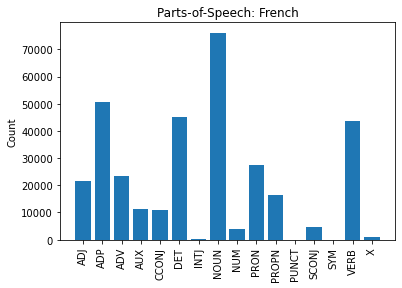

POS Tags: https://universaldependencies.org/docs/u/pos/
----
XLAT cache loaded (22,120 entries): gs://interlingual_term_translations/fr-en-xlat.json


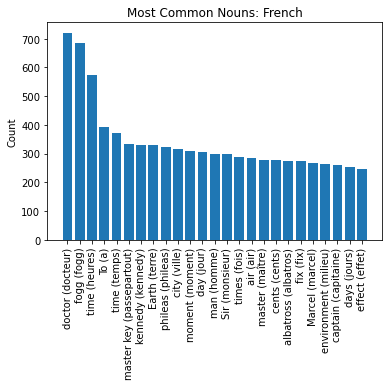

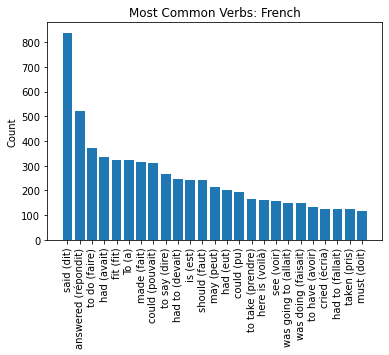

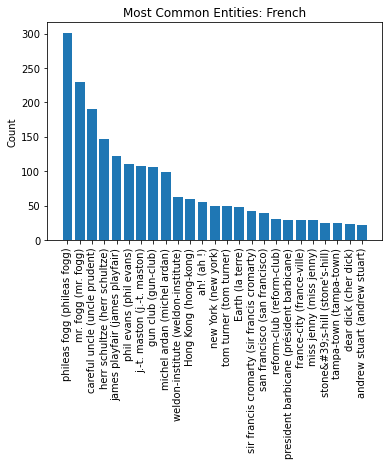

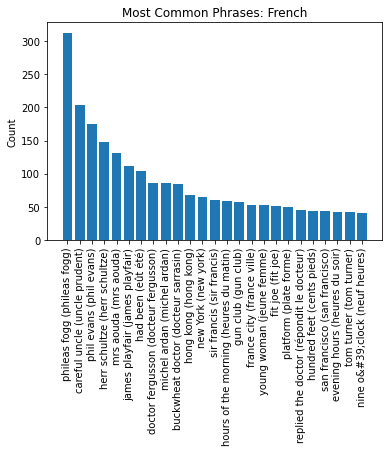

In [ ]:
# EDA

if PERFORM_EDA:
  corpus_eda('French',
             fr_nlp,
             jules_verne_texts,
             processors=cores)

### Preprocessing

In [ ]:
# advanced preprocessing

%time jules_verne_docs = advanced_preprocess(fr_nlp, \
                                             texts=jules_verne_texts, \
                                             processors=cores)

Terms: 152,306
Entities: 6,069
Phrases: 4,723
CPU times: user 3.75 s, sys: 278 ms, total: 4.03 s
Wall time: 1min 24s


## Filter Extremes

*2. The second step is to remove extreme terms from the processed corpus.*

In [ ]:
# remove extremeties in term frequencies

jules_verne_docs = filter_extremes(jules_verne_docs,
                                   no_below=1,
                                   no_above_frac=0.7,
                                   remove_empty_docs=True)

Empty documents removed: 0
Unique terms surviving: 16,378


## Topic Modeling

*3. The third step is to generate a topic model. The correct model parameters, including topic count, are inferred during this processing.*

Corpus Size: 7; Vocabulary Size: 16,378; Total Terms: 62,489


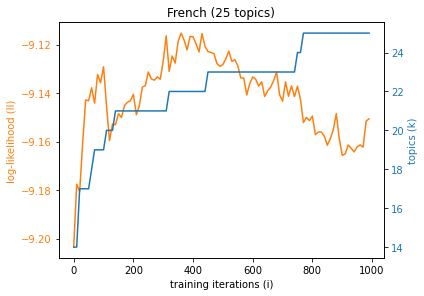

In [ ]:
jules_verne_model = create_hdp_model(jules_verne_docs,
                                     'French',
                                     hdp_params=dict(seed=42))

## Model Validation

*4. The fourth step is to validate a topic model. Since this is an unsupervised learning technique, a measure of coherence of model output is taken. Measures are calculated using 'c_v' coherence where values range 0-1 in increasing coherence.*

In [ ]:
print('Coherence: {:.4}'.format(
    tp.coherence.Coherence(jules_verne_model,
                           coherence='c_v').get_score()))

Coherence: 0.8758


## Visualization

*5. The final step is to visualize a topic model. Bubbles in the diagram represent topics and their relative importance in relation to the corpus. The relevance slider should be adjusted typically between 0.4 and 0.6 for best results. A lower relevance value prefers frequent terms most exclusive to a topic while a higher relevance value prefers terms which occur most frequently without regard to exclusivity. Using the next/previous topic buttons selects individual topics for analysis.*

In [ ]:
visualize_hdp_model(jules_verne_model, fr_nlp.lang)

XLAT cache loaded (22,120 entries): gs://interlingual_term_translations/fr-en-xlat.json
0 cache misses.


/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; se

# Europarl Parallel Language Samples

In the Europarl Parallel samples, the same steps as illustrated in the above simple French sample are performed. In these samples since five non-English language samples are analyzed in parallel with their English counterparts, each of the five steps is peformed on all of the parallel texts (five groups of two each) before proceeding. Using the "Table of contents" navigation available at left in Google Colab is useful for moving between the steps. Also, collapsing the subsections with the triangular arrows next to their titles helps to manage the content displayed.

## Process Parallel Samples

In [ ]:
# Europarl parallel samples of the several official EU languages

# samples are available within this repository

# characteristics: short aligned statment samples from the proceedings 
# of the European Parliament

gov_multi = 'https://raw.githubusercontent.com/jbrown544/' \
            'interlingual-topic-modeling/main/text/gov/multi'

lithuanian_europarl_url = (f'{gov_multi}/europarl-v7.lt-en.lt.150k', 
                           f'{gov_multi}/europarl-v7.lt-en.en.150k')

danish_europarl_url = (f'{gov_multi}/europarl-v7.da-en.da.150k',
                       f'{gov_multi}/europarl-v7.da-en.en.150k')

greek_europarl_url = (f'{gov_multi}/europarl-v7.el-en.el.75k',
                      f'{gov_multi}/europarl-v7.el-en.en.75k')

italian_europarl_url = (f'{gov_multi}/europarl-v7.it-en.it.150k',
                        f'{gov_multi}/europarl-v7.it-en.en.150k')

polish_europarl_url = (f'{gov_multi}/europarl-v7.pl-en.pl.150k',
                       f'{gov_multi}/europarl-v7.pl-en.en.150k')

The English statistical language model is required for every parallel sample processed.

In [ ]:
# load language model and inspect pipeline: English

en_nlp = spacy.load('en_core_web_sm')
print(f"{en_nlp.lang} pipeline: {en_nlp.pipe_names}")

en pipeline: ['tok2vec', 'tagger', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']


### Lithuanian (Baltic)

In [ ]:
# load language model and inspect pipeline: Lituanian

lt_nlp = spacy.load('lt_core_news_sm')
print(f'{lt_nlp.lang} pipeline: {lt_nlp.pipe_names}')

lt pipeline: ['tok2vec', 'morphologizer', 'tagger', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']


In [ ]:
# load encoded proceedings: Lithuanian

with open(lithuanian_europarl_url[0], encoding='utf-8') as non_en, \
     open(lithuanian_europarl_url[1], encoding='utf-8') as en:
     lithuanian_europarl_texts = (non_en.readlines(), en.readlines())

#### EDA Report

EDA Report: Lithuanian
----
Document count: 150,000
Sentence count: 299,098
Token count: 3,258,853
Word count: 2,563,421
----
Unique POS count: 17
Unique Word count: 113,359
Unique Noun count: 56,280
Unique Verb count: 40,492
Unique Entity count: 11,736
Unique Phrase count: 12,493
----
Avg. Tokens/Sentence: 10.9
Avg. Words/Sentence: 8.57
Avg. Tokens/Document: 21.73
Avg. Words/Document: 17.09
Avg. Sentences/Document: 1.99
----


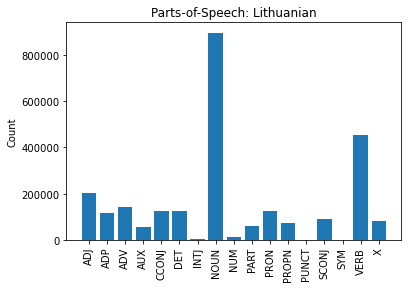

POS Tags: https://universaldependencies.org/docs/u/pos/
----
XLAT cache loaded (78,878 entries): gs://interlingual_term_translations/lt-en-xlat.json
Translating 7 terms.
XLAT cache persisted: gs://interlingual_term_translations/lt-en-xlat.json


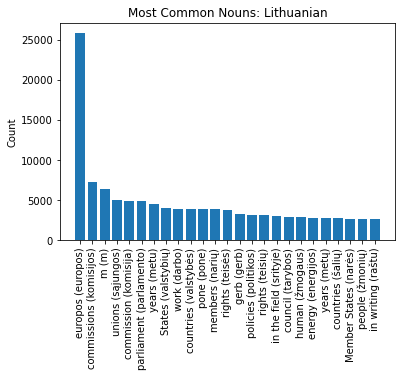

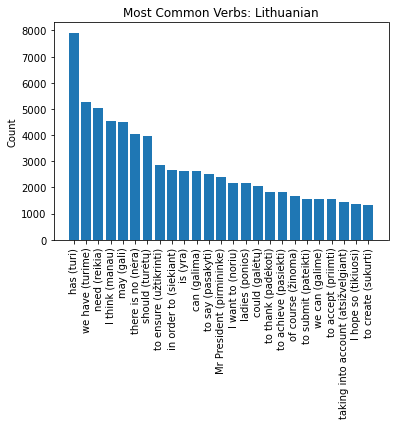

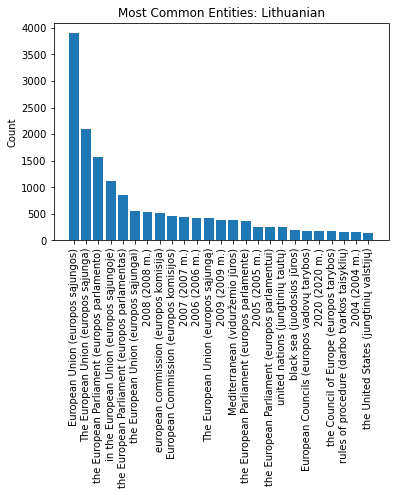

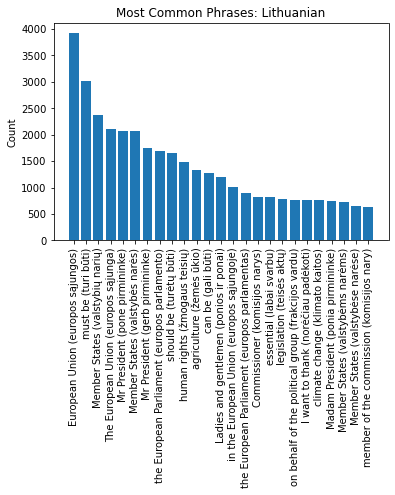

In [ ]:
# EDA: Lithuanian

if PERFORM_EDA:
  corpus_eda('Lithuanian',
             lt_nlp,
             lithuanian_europarl_texts[0],
             processors=cores)

EDA Report: Lithuanian->English
----
Document count: 150,000
Sentence count: 299,450
Token count: 4,133,467
Word count: 3,520,978
----
Unique POS count: 17
Unique Word count: 29,849
Unique Noun count: 19,593
Unique Verb count: 8,596
Unique Entity count: 16,594
Unique Phrase count: 7,467
----
Avg. Tokens/Sentence: 13.8
Avg. Words/Sentence: 11.76
Avg. Tokens/Document: 27.56
Avg. Words/Document: 23.47
Avg. Sentences/Document: 2.0
----


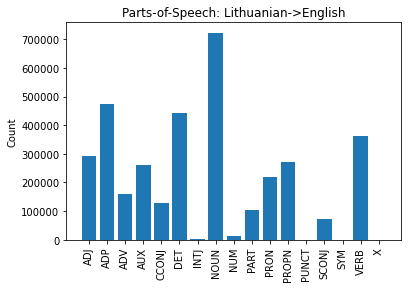

POS Tags: https://universaldependencies.org/docs/u/pos/
----


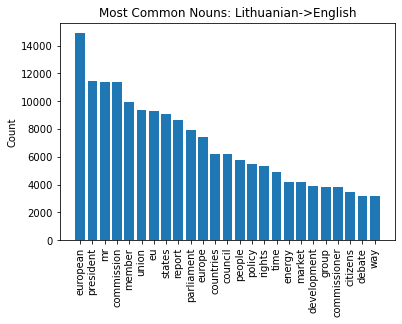

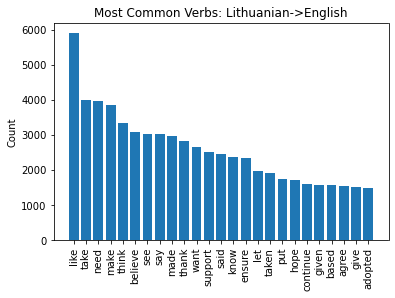

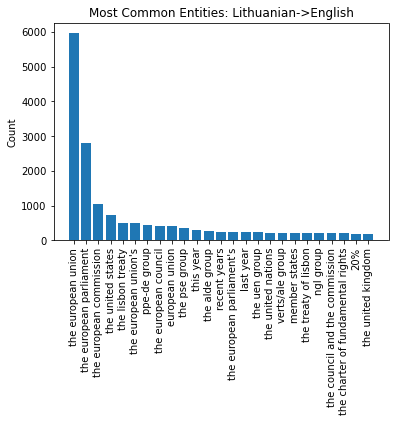

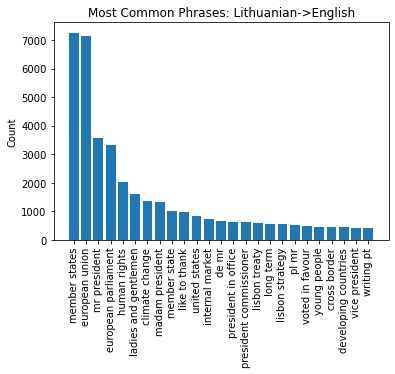

In [ ]:
# EDA: Lithuanian->English

if PERFORM_EDA:
  corpus_eda('Lithuanian->English',
             en_nlp,
             lithuanian_europarl_texts[1],
             processors=cores)

#### Preprocessing

In [ ]:
# advanced preprocessing: Lithuanian

%time lithuanian_europarl_docs = \
  (advanced_preprocess(lt_nlp, \
                       texts=lithuanian_europarl_texts[0], \
                       processors=cores), \
   advanced_preprocess(en_nlp, \
                       texts=lithuanian_europarl_texts[1], \
                       processors=cores))

Terms: 1,709,537
Entities: 46,054
Phrases: 239,233
Terms: 1,579,318
Entities: 66,213
Phrases: 199,558
CPU times: user 5min 40s, sys: 4.95 s, total: 5min 45s
Wall time: 6min 5s


### Danish (Germanic)

In [ ]:
# load language model and inspect pipeline: Danish

da_nlp = spacy.load('da_core_news_lg')
print(f'{da_nlp.lang} pipeline: {da_nlp.pipe_names}')

da pipeline: ['tok2vec', 'morphologizer', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']


In [ ]:
# load encoded proceedings: Danish

with open(danish_europarl_url[0], encoding='utf-8') as non_en, \
     open(danish_europarl_url[1], encoding='utf-8') as en:
     danish_europarl_texts = (non_en.readlines(), en.readlines())

#### EDA Report

EDA Report: Danish
----
Document count: 150,000
Sentence count: 299,764
Token count: 4,036,784
Word count: 3,342,951
----
Unique POS count: 17
Unique Word count: 73,051
Unique Noun count: 53,991
Unique Verb count: 10,903
Unique Entity count: 4,586
Unique Phrase count: 7,010
----
Avg. Tokens/Sentence: 13.47
Avg. Words/Sentence: 11.15
Avg. Tokens/Document: 26.91
Avg. Words/Document: 22.29
Avg. Sentences/Document: 2.0
----


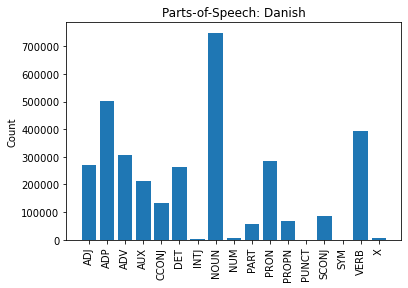

POS Tags: https://universaldependencies.org/docs/u/pos/
----
XLAT cache loaded (52,356 entries): gs://interlingual_term_translations/da-en-xlat.json
Translating 1 terms.
XLAT cache persisted: gs://interlingual_term_translations/da-en-xlat.json


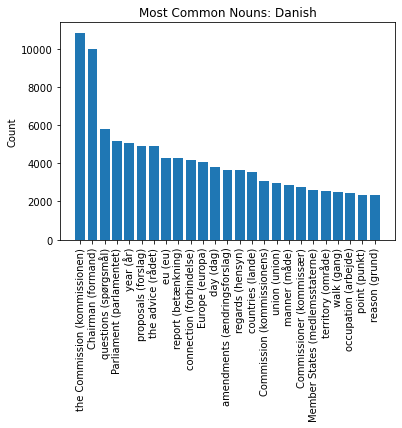

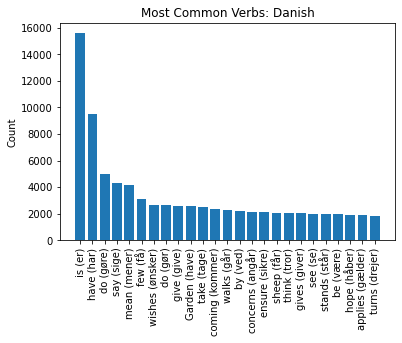

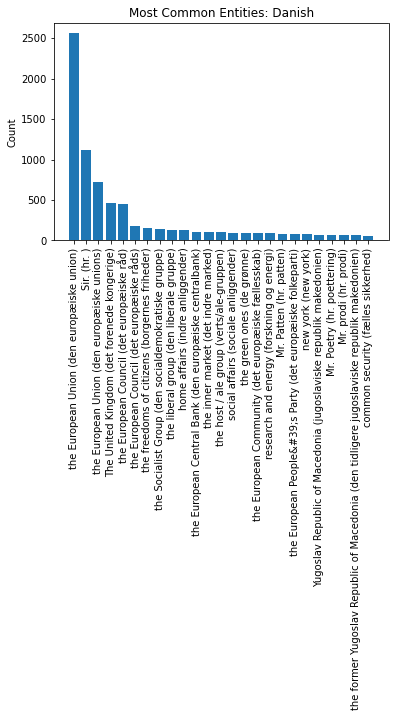

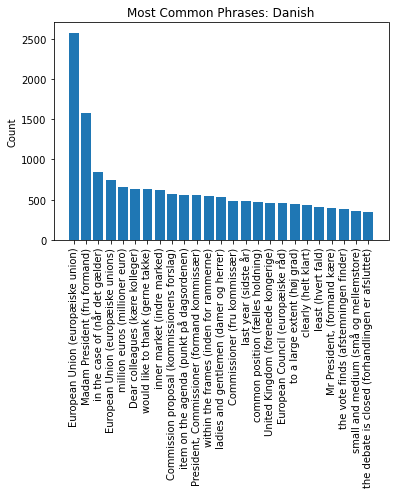

In [ ]:
# EDA: Danish

if PERFORM_EDA:
  corpus_eda('Danish',
             da_nlp,
             danish_europarl_texts[0],
             processors=cores)

EDA Report: Danish->English
----
Document count: 150,000
Sentence count: 299,189
Token count: 4,326,011
Word count: 3,720,497
----
Unique POS count: 16
Unique Word count: 29,353
Unique Noun count: 18,896
Unique Verb count: 8,698
Unique Entity count: 16,250
Unique Phrase count: 7,357
----
Avg. Tokens/Sentence: 14.46
Avg. Words/Sentence: 12.44
Avg. Tokens/Document: 28.84
Avg. Words/Document: 24.8
Avg. Sentences/Document: 1.99
----


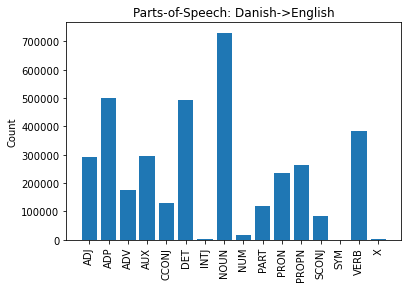

POS Tags: https://universaldependencies.org/docs/u/pos/
----


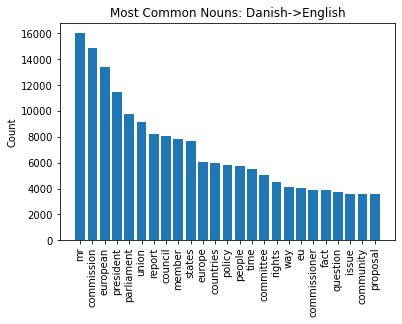

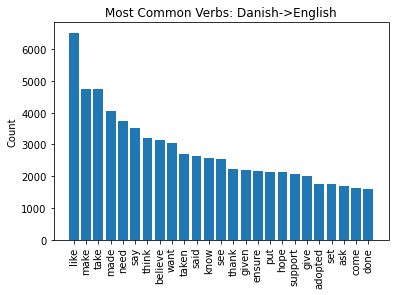

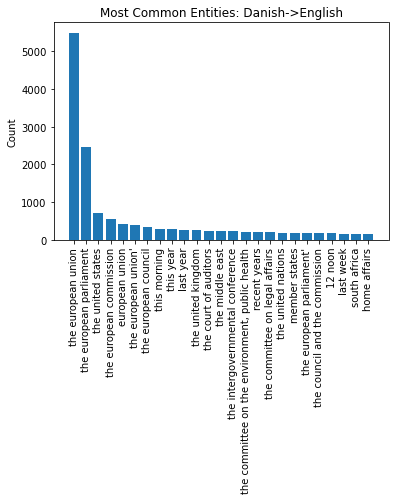

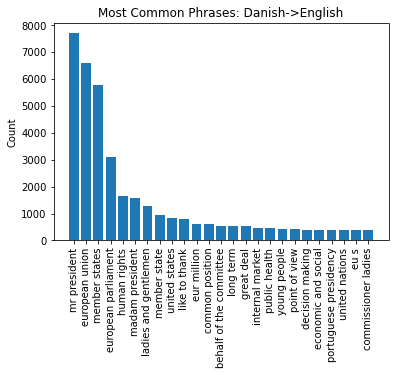

In [ ]:
# EDA: Danish->English

if PERFORM_EDA:
  corpus_eda('Danish->English',
             en_nlp,
             danish_europarl_texts[1],
             processors=cores)

#### Preprocessing

In [ ]:
# advanced preprocessing: Danish

%time danish_europarl_docs = \
    (advanced_preprocess(da_nlp, \
                         texts=danish_europarl_texts[0], \
                         processors=cores), \
    advanced_preprocess(en_nlp, \
                        texts=danish_europarl_texts[1], \
                        processors=cores))

Terms: 1,410,667
Entities: 19,630
Phrases: 144,737
Terms: 1,608,781
Entities: 67,069
Phrases: 188,902
CPU times: user 5min 44s, sys: 5.05 s, total: 5min 49s
Wall time: 6min 20s


### Greek (Greek)

In [ ]:
# load language model and inspect pipeline: Greek

el_nlp = spacy.load('el_core_news_lg')
print(f'{el_nlp.lang} pipeline: {el_nlp.pipe_names}')

el pipeline: ['tok2vec', 'morphologizer', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']


In [ ]:
# load encoded proceedings: Greek

with open(greek_europarl_url[0], encoding='utf-8') as non_en, \
     open(greek_europarl_url[1], encoding='utf-8') as en:
     greek_europarl_texts = (non_en.readlines(), en.readlines())

#### EDA Report

EDA Report: Greek
----
Document count: 75,000
Sentence count: 149,550
Token count: 2,202,932
Word count: 1,896,311
----
Unique POS count: 15
Unique Word count: 54,729
Unique Noun count: 18,730
Unique Verb count: 17,447
Unique Entity count: 2,709
Unique Phrase count: 5,654
----
Avg. Tokens/Sentence: 14.73
Avg. Words/Sentence: 12.68
Avg. Tokens/Document: 29.37
Avg. Words/Document: 25.28
Avg. Sentences/Document: 1.99
----


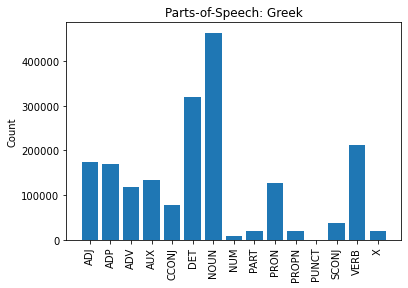

POS Tags: https://universaldependencies.org/docs/u/pos/
----
XLAT cache loaded (37,814 entries): gs://interlingual_term_translations/el-en-xlat.json
Translating 6 terms.
XLAT cache persisted: gs://interlingual_term_translations/el-en-xlat.json


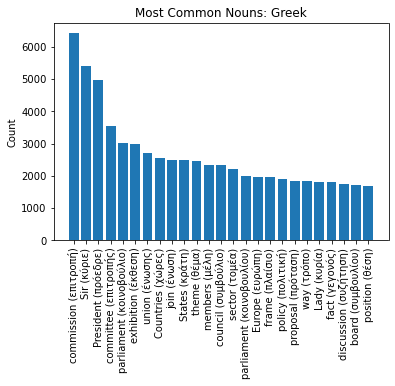

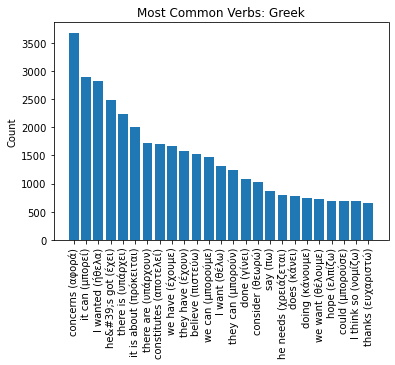

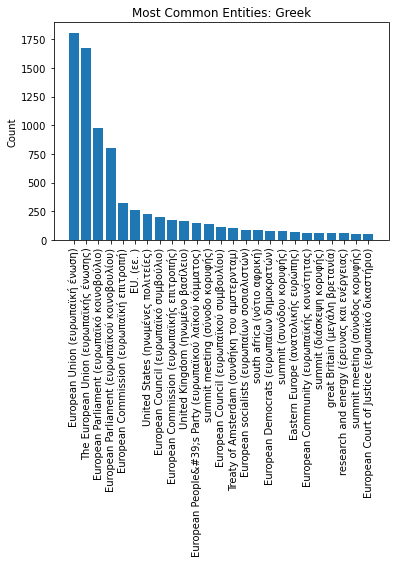

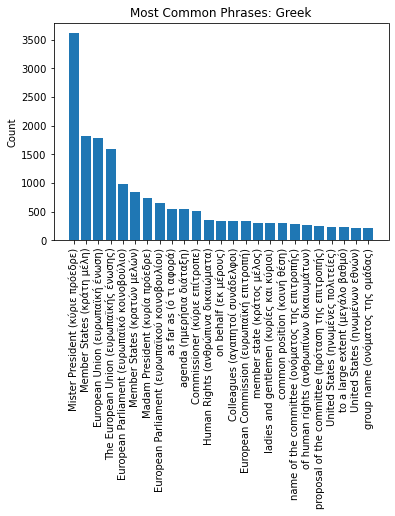

In [ ]:
# EDA: Greek

if PERFORM_EDA:
  corpus_eda('Greek',
             el_nlp,
             greek_europarl_texts[0],
             processors=cores)

EDA Report: Greek->English
----
Document count: 75,000
Sentence count: 149,668
Token count: 2,233,019
Word count: 1,923,822
----
Unique POS count: 16
Unique Word count: 23,118
Unique Noun count: 14,090
Unique Verb count: 7,035
Unique Entity count: 9,785
Unique Phrase count: 4,133
----
Avg. Tokens/Sentence: 14.92
Avg. Words/Sentence: 12.85
Avg. Tokens/Document: 29.77
Avg. Words/Document: 25.65
Avg. Sentences/Document: 2.0
----


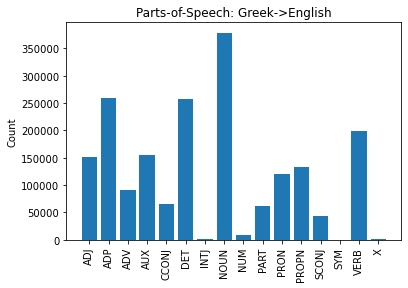

POS Tags: https://universaldependencies.org/docs/u/pos/
----


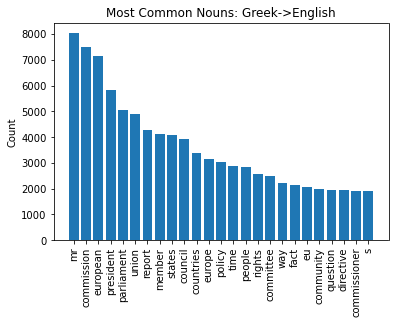

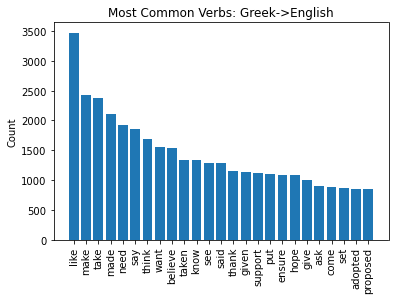

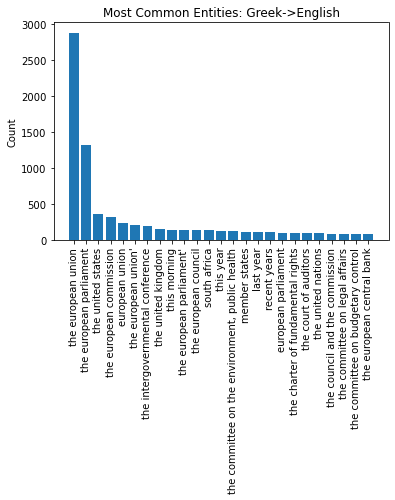

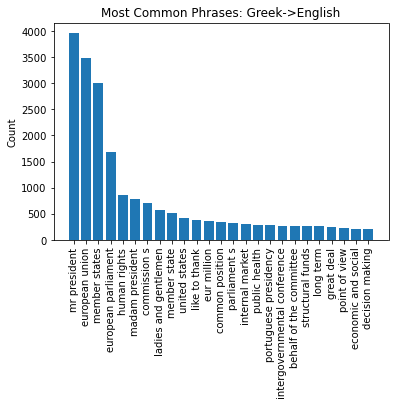

In [ ]:
# EDA: Greek->English

if PERFORM_EDA:
  corpus_eda('Greek->English',
             en_nlp,
             greek_europarl_texts[1],
             processors=cores)

#### Preprocessing

In [ ]:
# advanced preprocessing: Greek

%time greek_europarl_docs = \
  (advanced_preprocess(el_nlp, \
                       texts=greek_europarl_texts[0], \
                       processors=cores), \
   advanced_preprocess(en_nlp, \
                       texts=greek_europarl_texts[1], \
                       processors=cores))          

Terms: 874,149
Entities: 15,024
Phrases: 91,106
Terms: 830,615
Entities: 34,055
Phrases: 89,202
CPU times: user 2min 59s, sys: 3.12 s, total: 3min 2s
Wall time: 5min 30s


### Italian (Romance)

In [ ]:
# load language model and inspect pipeline: Italian

it_nlp = spacy.load('it_core_news_lg')
print(f'{it_nlp.lang} pipeline: {it_nlp.pipe_names}')

it pipeline: ['tok2vec', 'morphologizer', 'tagger', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']


In [ ]:
# load encoded proceedings: Italian

with open(italian_europarl_url[0], encoding='utf-8') as non_en, \
     open(italian_europarl_url[1], encoding='utf-8') as en:
     italian_europarl_texts = (non_en.readlines(), en.readlines())

#### EDA Report

EDA Report: Italian
----
Document count: 150,000
Sentence count: 299,496
Token count: 4,518,756
Word count: 3,796,459
----
Unique POS count: 16
Unique Word count: 52,797
Unique Noun count: 20,785
Unique Verb count: 23,302
Unique Entity count: 12,135
Unique Phrase count: 9,754
----
Avg. Tokens/Sentence: 15.09
Avg. Words/Sentence: 12.68
Avg. Tokens/Document: 30.13
Avg. Words/Document: 25.31
Avg. Sentences/Document: 2.0
----


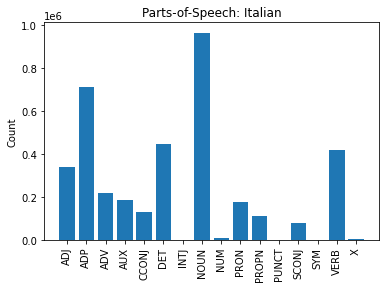

POS Tags: https://universaldependencies.org/docs/u/pos/
----
XLAT cache loaded (35,183 entries): gs://interlingual_term_translations/it-en-xlat.json
Translating 2 terms.
XLAT cache persisted: gs://interlingual_term_translations/it-en-xlat.json


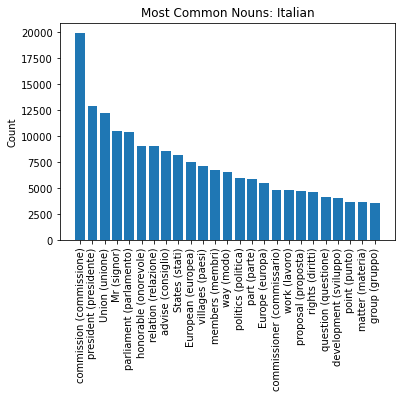

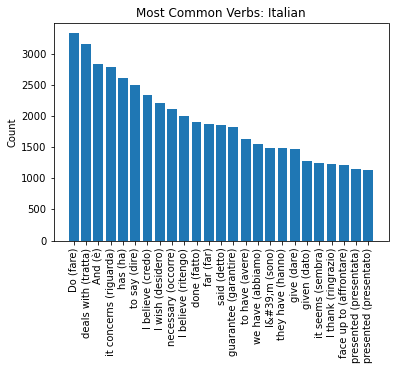

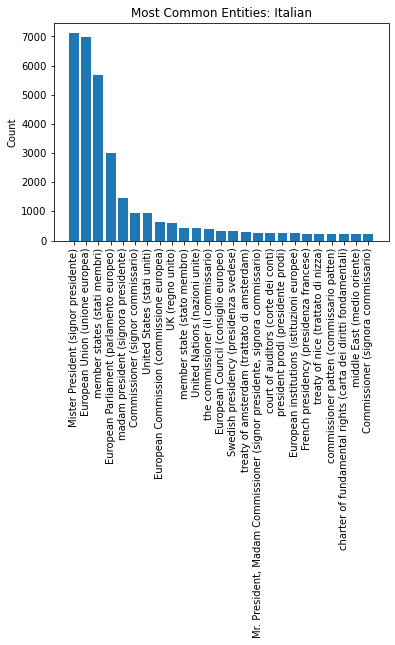

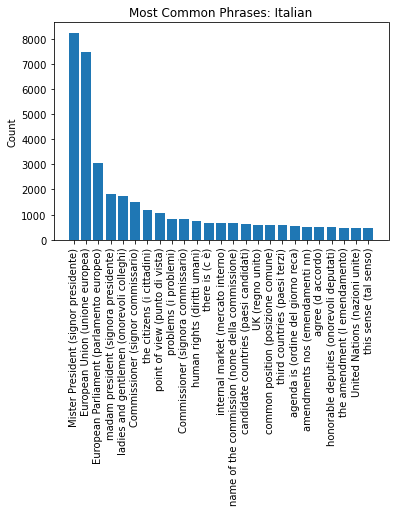

In [ ]:
# EDA: Italian

if PERFORM_EDA:
  corpus_eda('Italian',
             it_nlp,
             italian_europarl_texts[0],
             processors=cores)

EDA Report: Italian->English
----
Document count: 150,000
Sentence count: 299,653
Token count: 4,591,874
Word count: 3,957,102
----
Unique POS count: 16
Unique Word count: 30,006
Unique Noun count: 19,409
Unique Verb count: 8,856
Unique Entity count: 16,967
Unique Phrase count: 7,761
----
Avg. Tokens/Sentence: 15.32
Avg. Words/Sentence: 13.21
Avg. Tokens/Document: 30.61
Avg. Words/Document: 26.38
Avg. Sentences/Document: 2.0
----


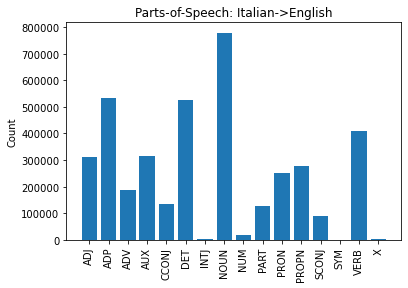

POS Tags: https://universaldependencies.org/docs/u/pos/
----


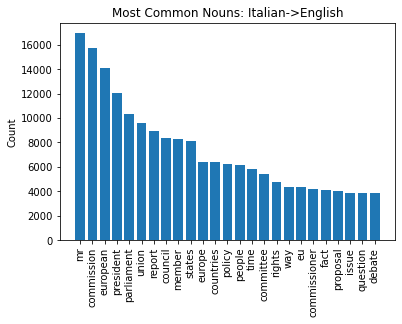

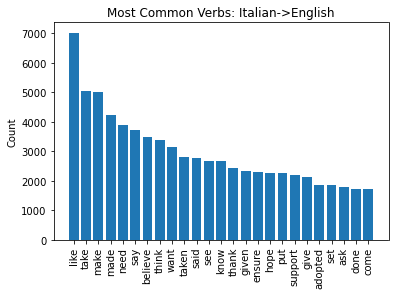

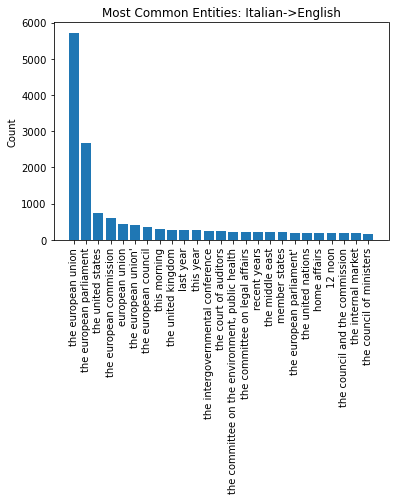

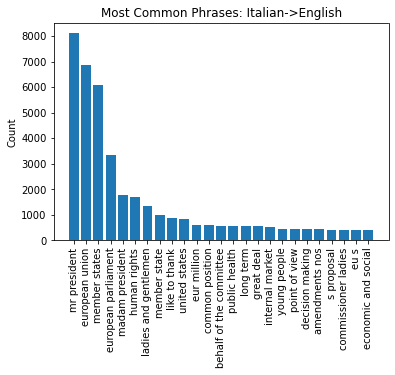

In [ ]:
# EDA: Italian->English

if PERFORM_EDA:
  corpus_eda('Italian->English',
             en_nlp,
             italian_europarl_texts[1],
             processors=cores)

#### Preprocessing

In [ ]:
# advanced preprocessing: Italian

%time italian_europarl_docs = \
  (advanced_preprocess(it_nlp, \
                       texts=italian_europarl_texts[0], \
                       processors=cores), \
   advanced_preprocess(en_nlp, \
                       texts=italian_europarl_texts[1], \
                       processors=cores))      

Terms: 1,706,058
Entities: 64,674
Phrases: 203,349
Terms: 1,712,019
Entities: 70,999
Phrases: 203,152
CPU times: user 6min, sys: 5.32 s, total: 6min 5s
Wall time: 6min 48s


### Polish (Slavic)

In [ ]:
# load language model and inspect pipeline: Polish

pl_nlp = spacy.load('pl_core_news_lg')
print(f'{pl_nlp.lang} pipeline: {pl_nlp.pipe_names}')

pl pipeline: ['tok2vec', 'morphologizer', 'parser', 'tagger', 'attribute_ruler', 'lemmatizer', 'ner']


In [ ]:
# load encoded proceedings: Polish

with open(polish_europarl_url[0], encoding='utf-8') as non_en, \
     open(polish_europarl_url[1], encoding='utf-8') as en:
     polish_europarl_texts = (non_en.readlines(), en.readlines())

#### EDA Report

EDA Report: Polish
----
Document count: 150,000
Sentence count: 299,944
Token count: 3,581,908
Word count: 2,928,209
----
Unique POS count: 17
Unique Word count: 91,733
Unique Noun count: 39,508
Unique Verb count: 19,528
Unique Entity count: 8,888
Unique Phrase count: 15,314
----
Avg. Tokens/Sentence: 11.94
Avg. Words/Sentence: 9.76
Avg. Tokens/Document: 23.88
Avg. Words/Document: 19.52
Avg. Sentences/Document: 2.0
----


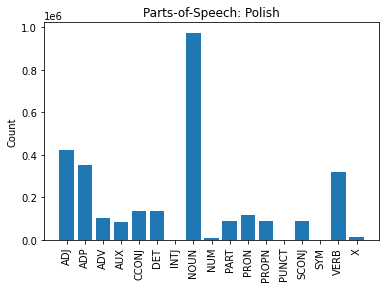

POS Tags: https://universaldependencies.org/docs/u/pos/
----
XLAT cache loaded (51,871 entries): gs://interlingual_term_translations/pl-en-xlat.json
Translating 8 terms.
XLAT cache persisted: gs://interlingual_term_translations/pl-en-xlat.json


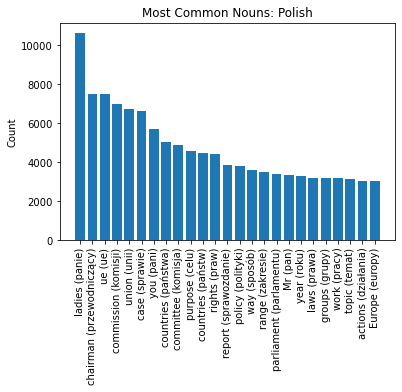

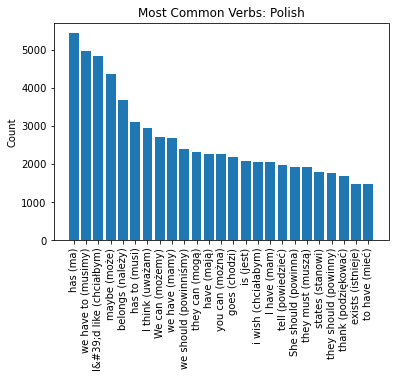

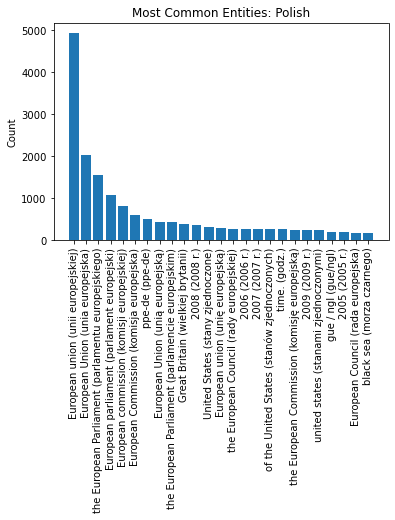

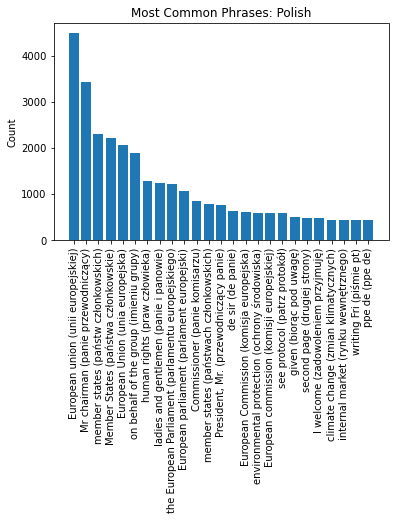

In [ ]:
# EDA: Polish

if PERFORM_EDA:
  corpus_eda('Polish',
             pl_nlp,
             polish_europarl_texts[0],
             processors=cores)

EDA Report: Polish->English
----
Document count: 150,000
Sentence count: 299,206
Token count: 4,119,913
Word count: 3,509,689
----
Unique POS count: 17
Unique Word count: 29,719
Unique Noun count: 19,469
Unique Verb count: 8,577
Unique Entity count: 16,495
Unique Phrase count: 7,480
----
Avg. Tokens/Sentence: 13.77
Avg. Words/Sentence: 11.73
Avg. Tokens/Document: 27.47
Avg. Words/Document: 23.4
Avg. Sentences/Document: 1.99
----


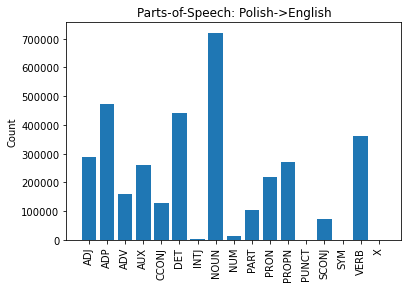

POS Tags: https://universaldependencies.org/docs/u/pos/
----


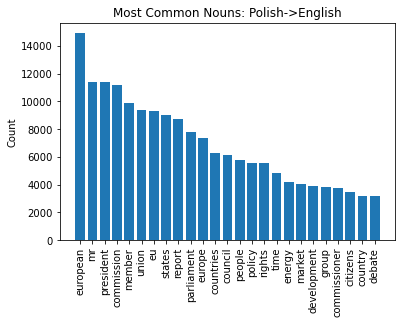

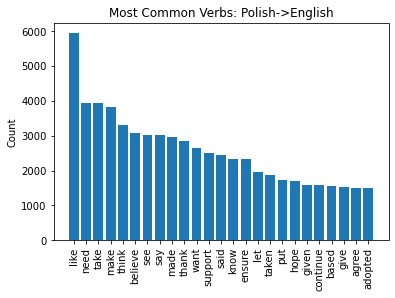

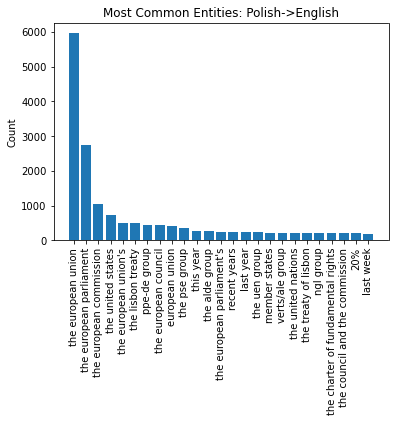

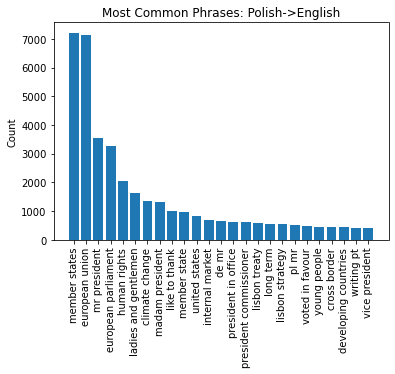

In [ ]:
# EDA: Polish->English

if PERFORM_EDA:
  corpus_eda('Polish->English',
             en_nlp,
             polish_europarl_texts[1],
             processors=cores)

#### Preprocessing

In [ ]:
# advanced preprocessing: Polish

%time polish_europarl_docs = \
    (advanced_preprocess(pl_nlp, \
                         texts=polish_europarl_texts[0], \
                         processors=cores), \
    advanced_preprocess(en_nlp, \
                        texts=polish_europarl_texts[1], \
                        processors=cores))          

Terms: 1,767,855
Entities: 43,320
Phrases: 260,937
Terms: 1,575,021
Entities: 66,053
Phrases: 199,315
CPU times: user 5min 54s, sys: 5.52 s, total: 5min 59s
Wall time: 7min 29s


## Filter Extremes

In [ ]:
# filtration parameters

filter_params = dict(
    no_below=10,
    no_above_frac=0.01,
    remove_empty_docs=True
)

In [ ]:
# filter corpus terms: Lithuanian

lithuanian_europarl_docs_filt = \
  (filter_extremes(lithuanian_europarl_docs[0], **filter_params), \
   filter_extremes(lithuanian_europarl_docs[1], **filter_params))

Empty documents removed: 4,303
Unique terms surviving: 15,410
Empty documents removed: 4,855
Unique terms surviving: 12,094


In [ ]:
# filter corpus terms: Danish

danish_europarl_docs_filt = \
  (filter_extremes(danish_europarl_docs[0], **filter_params), \
   filter_extremes(danish_europarl_docs[1], **filter_params))

Empty documents removed: 3,566
Unique terms surviving: 11,972
Empty documents removed: 4,313
Unique terms surviving: 12,274


In [ ]:
# filter corpus terms: Greek

greek_europarl_docs_filt = \
  (filter_extremes(greek_europarl_docs[0], **filter_params), \
   filter_extremes(greek_europarl_docs[1], **filter_params))

Empty documents removed: 1,729
Unique terms surviving: 10,486
Empty documents removed: 2,148
Unique terms surviving: 7,824


In [ ]:
# filter corpus terms: Italian

italian_europarl_docs_filt = \
  (filter_extremes(italian_europarl_docs[0], **filter_params), \
   filter_extremes(italian_europarl_docs[1], **filter_params))

Empty documents removed: 2,605
Unique terms surviving: 13,734
Empty documents removed: 3,514
Unique terms surviving: 12,799


In [ ]:
# filter corpus terms: Polish

polish_europarl_docs_filt = \
  (filter_extremes(polish_europarl_docs[0], **filter_params), \
   filter_extremes(polish_europarl_docs[1], **filter_params))

Empty documents removed: 2,797
Unique terms surviving: 17,124
Empty documents removed: 5,094
Unique terms surviving: 12,019


## Topic Modeling

In [ ]:
# modeling parameters

model_params = dict(
    processors=1,
    hdp_params=dict(seed=42)
)

# This is much faster, but counteracts repeatability (from a seed value)
# this is assumed to be due to variability in processor core scheduling
if DEBUG:
  model_params['processors'] = cores

### Lithuanian (Baltic)

Corpus Size: 145,697; Vocabulary Size: 15,410; Total Terms: 1,160,643


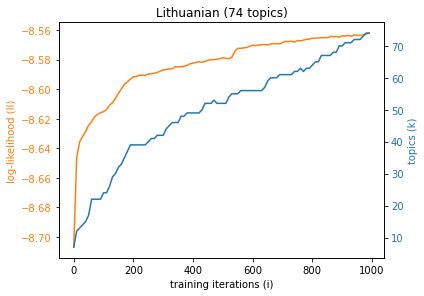

Corpus Size: 145,145; Vocabulary Size: 12,094; Total Terms: 1,103,871


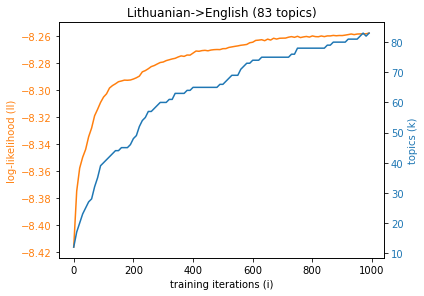

CPU times: user 13min 57s, sys: 4.7 s, total: 14min 1s
Wall time: 3min 10s


In [ ]:
# build models: Lithuanian

%time lithuanian_models = (create_hdp_model(lithuanian_europarl_docs_filt[0], \
                                            'Lithuanian', \
                                            **model_params), \
                           create_hdp_model(lithuanian_europarl_docs_filt[1], \
                                            'Lithuanian->English', \
                                            **model_params))

### Danish (Germanic)

Corpus Size: 146,434; Vocabulary Size: 11,972; Total Terms: 1,030,382


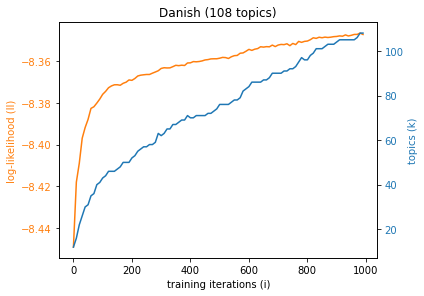

Corpus Size: 145,687; Vocabulary Size: 12,274; Total Terms: 1,105,430


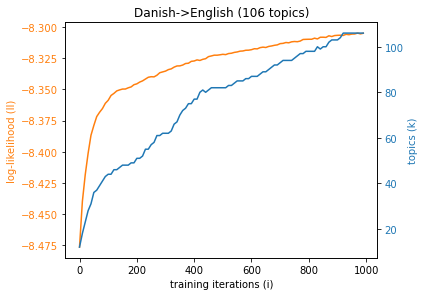

CPU times: user 15min 19s, sys: 5.71 s, total: 15min 24s
Wall time: 3min 31s


In [ ]:
# build models: Danish

%time danish_models = (create_hdp_model(danish_europarl_docs_filt[0], \
                                        'Danish', \
                                        **model_params), \
                       create_hdp_model(danish_europarl_docs_filt[1], \
                                        'Danish->English', \
                                        **model_params))

### Greek (Greek)

Corpus Size: 73,271; Vocabulary Size: 10,486; Total Terms: 608,402


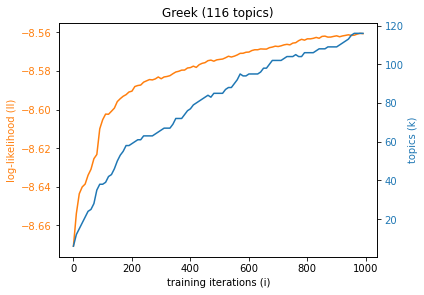

Corpus Size: 72,852; Vocabulary Size: 7,824; Total Terms: 534,319


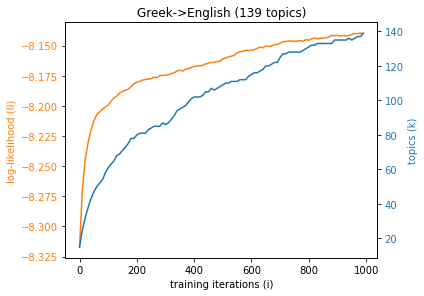

CPU times: user 8min 30s, sys: 4.36 s, total: 8min 34s
Wall time: 2min


In [ ]:
# build models: Greek

%time greek_models = (create_hdp_model(greek_europarl_docs_filt[0], \
                                       'Greek', \
                                       **model_params), \
                      create_hdp_model(greek_europarl_docs_filt[1], \
                                       'Greek->English', \
                                       **model_params))

### Italian (Romance)

Corpus Size: 147,395; Vocabulary Size: 13,734; Total Terms: 1,237,337


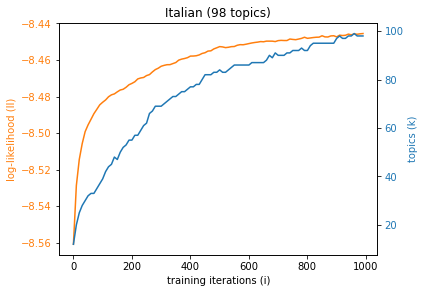

Corpus Size: 146,486; Vocabulary Size: 12,799; Total Terms: 1,150,800


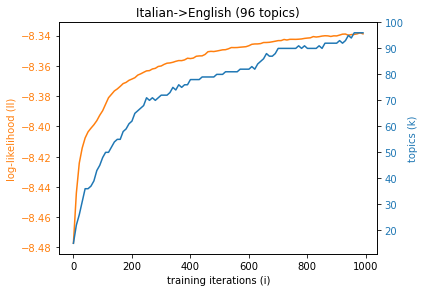

CPU times: user 15min 47s, sys: 5.1 s, total: 15min 52s
Wall time: 3min 36s


In [ ]:
# build models: Italian

%time italian_models = (create_hdp_model(italian_europarl_docs_filt[0], \
                                         'Italian', \
                                         **model_params), \
                        create_hdp_model(italian_europarl_docs_filt[1], \
                                         'Italian->English', \
                                         **model_params))

### Polish (Slavic)

Corpus Size: 147,203; Vocabulary Size: 17,124; Total Terms: 1,264,117


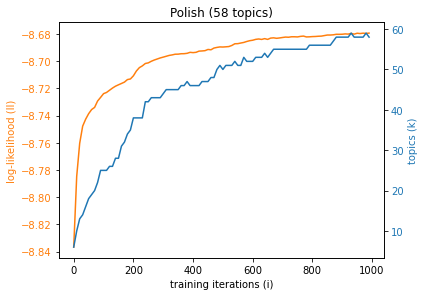

Corpus Size: 144,906; Vocabulary Size: 12,019; Total Terms: 1,097,396


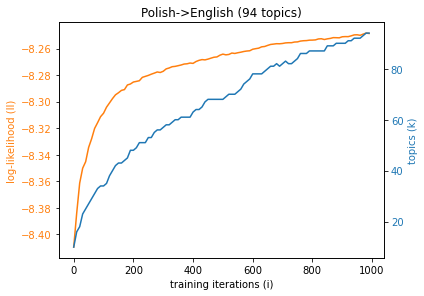

CPU times: user 14min 14s, sys: 4.01 s, total: 14min 18s
Wall time: 3min 16s


In [ ]:
# build models: Polish

%time polish_models = (create_hdp_model(polish_europarl_docs_filt[0], \
                                        'Polish', \
                                        **model_params), \
                       create_hdp_model(polish_europarl_docs_filt[1], \
                                        'Polish->English', \
                                        **model_params))

## Model Validation

In [ ]:
# validation parameters

validation_params = dict(
    coherence='c_v'
)

### Lithuanian (Baltic)

In [ ]:
# compute coherence: Lithuanian

print('Lithuanian: {:.4}'.format(
    tp.coherence.Coherence(lithuanian_models[0],
                           **validation_params).get_score()))
print('English: {:.4}'.format(
    tp.coherence.Coherence(lithuanian_models[1],
                           **validation_params).get_score()))

Lithuanian: 0.8335
English: 0.8226


### Danish (Germanic)

In [ ]:
# compute coherence: Danish

print('Danish: {:.4}'.format(
    tp.coherence.Coherence(danish_models[0],
                           **validation_params).get_score()))
print('English: {:.4}'.format(
    tp.coherence.Coherence(danish_models[1],
                           **validation_params).get_score()))

Danish: 0.855
English: 0.8481


### Greek (Greek)

In [ ]:
# compute coherence: Greek

print('Greek: {:.4}'.format(
    tp.coherence.Coherence(greek_models[0],
                           **validation_params).get_score()))
print('English: {:.4}'.format(
    tp.coherence.Coherence(greek_models[1],
                           **validation_params).get_score()))

Greek: 0.8642
English: 0.8788


### Italian (Romance)

In [ ]:
# compute coherence: Italian

print('Italian: {:.4}'.format(
    tp.coherence.Coherence(italian_models[0],
                           **validation_params).get_score()))
print('English: {:.4}'.format(
    tp.coherence.Coherence(italian_models[1],
                           **validation_params).get_score()))

Italian: 0.859
English: 0.8492


### Polish (Slavic)

In [ ]:
# compute coherence: Polish

print('Polish: {:.4}'.format(
    tp.coherence.Coherence(polish_models[0],
                           **validation_params).get_score()))
print('English: {:.4}'.format(
    tp.coherence.Coherence(polish_models[1],
                           **validation_params).get_score()))

Polish: 0.8358
English: 0.8318


## Visualization

### Lithuanian (Baltic)

In [ ]:
visualize_hdp_model(lithuanian_models[0], lt_nlp.lang)

XLAT cache loaded (78,885 entries): gs://interlingual_term_translations/lt-en-xlat.json
0 cache misses.


/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/opt/conda/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; se

In [ ]:
visualize_hdp_model(lithuanian_models[1])

### Danish (Germanic)

In [ ]:
visualize_hdp_model(danish_models[0], da_nlp.lang)

XLAT cache loaded (52,357 entries): gs://interlingual_term_translations/da-en-xlat.json
0 cache misses.


In [ ]:
visualize_hdp_model(danish_models[1])

### Greek (Greek)

In [ ]:
visualize_hdp_model(greek_models[0], el_nlp.lang)

XLAT cache loaded (37,820 entries): gs://interlingual_term_translations/el-en-xlat.json
0 cache misses.


In [ ]:
visualize_hdp_model(greek_models[1])

### Italian (Romance)

In [ ]:
visualize_hdp_model(italian_models[0], it_nlp.lang)

XLAT cache loaded (35,185 entries): gs://interlingual_term_translations/it-en-xlat.json
0 cache misses.


In [ ]:
visualize_hdp_model(italian_models[1])

### Polish (Slavic)

In [ ]:
visualize_hdp_model(polish_models[0], pl_nlp.lang)

XLAT cache loaded (51,879 entries): gs://interlingual_term_translations/pl-en-xlat.json
0 cache misses.


In [ ]:
visualize_hdp_model(polish_models[1])

## Notes

*   Lithuanian (Baltic) final line - limited to 150k lines due to text size
*   Galiausiai, mes negalime sutikti su tolimesniais ES teisės aktais dėl nelaimių prevencijos ir pajėgumo reaguoti į jas.
*   English final line
*   Finally, we cannot agree with further EU legislation in the area of disaster prevention and response.
*   Google translate version
*   Finally, we cannot agree to further EU legislation on disaster prevention and response capacity.

*   Danish (Germanic) final line - limited to 150k lines due to text size
*   De beretter om forsvindinger, henrettelser uden dom, tortur, massegrave og overfyldte fængsler.
*   English final line
*   They are referring to disappearances, extra-judicial executions, tortures, mass graves and overcrowded prisons.
*   Google translate version
*   They report disappearances, executions without trial, torture, mass graves and overcrowded prisons.



*   Greek (Greek) final line - limited to 75k lines due to text size
*   Από το άρθρο αυτό προκύπτει ότι δεν τίθεται θέμα της πολιτικής για την ανάπτυξη που ακολουθούν τα κράτη μέλη.
*   English final line
*   From this article, it is clear that there is no question of replacing the Member States' development policy.
*   Google translate version
*   It follows from this article that there is no question of the development policy pursued by the Member States.

*   Italian (Romance) final line - limited to 150k lines due to text size
*   Signor Presidente, il Presidente Lincoln diceva che ci si può sempre prender gioco di alcuni, talvolta di tutti, ma non sempre di tutti.
*   English final line
*   Mr President, President Lincoln said you can fool some of the people all the time, all the people some of the time, but you cannot fool all the people all the time.
*   Google translate version
*   Mr. President, President Lincoln said that you can always make fun of some, sometimes of all, but not always of all.

*   Polish (Slavic) final line - limited to 150k lines due to text size
*   To byłoby rozwiązaniem bardziej inteligentnym, zdrowszym, bezpieczniejszym i bardziej przyjaznym środowisku.
*   English final line
*   That would be more intelligent, healthier, safer and greener.
*   Google translate version
*   That would be more intelligent, healthier, safer and greener.